<p style="font-size:3em">Classify marketplace's goods</p>

<br/>

This notebook corresponds to the second part of the **6th project of my data scientist path** with **OpenClassrooms/CentralSupelec** 

This project aims to provide the necessary skills to work on NLP and Image classification problems

This second notebook contains the image classification part :<br>

* Preprocessing (ColorToGrayScale, Equalizer, Gaussian/Median Blur, Resizing
* Test of ORB method (Bag of VisualWords)
* CNN VGG16 Transfer Learning
* CNN VGG16 Features Extraction (+Kmeans)
* CNN new network from scratch
                 
___ 
<b>I strongly recommend to use the 'table of content' extension of Jupyter to navigate through this notebook </b>

# Imports

In [339]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import pickle
import cv2


from sklearn.model_selection import train_test_split
from sklearn import metrics, cluster, decomposition
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.model_selection import GridSearchCV,cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score,plot_confusion_matrix,confusion_matrix


from sklearn.pipeline import make_pipeline
from sklearn.base import TransformerMixin,BaseEstimator


from keras.applications.vgg16 import VGG16
from keras.models import Sequential, Model, model_from_json
from keras.layers import Dense, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras.callbacks import EarlyStopping
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input

from sklearn.manifold import TSNE

from matplotlib.pyplot import imshow
from PIL import Image

In [310]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

In [5]:
train.head(3)

,category,description,image
0,Home Decor & Festive Needs,Specifications of Eternity Handcrafted unique ...,0bb0f7b7a3075f4b9459121abe2185fa.jpg
1,Baby Care,Key Features of Dongli Striped Baby Boy's Polo...,9ff54c12cc7ffd7c1a6724477b8fea2f.jpg
2,Beauty and Personal Care,Key Features of TIGI BED HEAD COLOUR GODDESS O...,4e09d5a71d46d61de3d4c9c5aedb73f2.jpg


In [4]:
train.dtypes

category       object
description    object
image          object
dtype: object

## First overview of dataset image

In [304]:
nb_img= 0

In [305]:
# create a path variable a access a specific image through its path contained in our dataset in the "image" column

path = "./Images/" + train.iloc[nb_img,2]
path

'./Images/0bb0f7b7a3075f4b9459121abe2185fa.jpg'

In [306]:
train.iloc[nb_img,1]

'Specifications of Eternity Handcrafted unique Mosaic Glass Table Lamp (35 cm, Blue) In The Box Sales Package 1 Table Lamp Number of Contents in Sales Package Pack of 1 General Type Buffet, Desk Color Blue Lamp Body Material Glass Lamp Base Material Metal Bulb Type 1x15 LED, CFSL ,Bulb Light Color Blue Assembly Required No Model Name Handcrafted unique Mosaic Glass Model Number Eternity001007 Power Features Power Requirement 110-240V, 50/60Hz Power Source Ac Additional Features Handcrafted\xa0lamps Dimensions Width 15 cm Height 35 cm Weight 1000 g'

In [307]:
img = cv2.imread(path)
img =cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img_g = cv2.imread(path,cv2.IMREAD_GRAYSCALE)

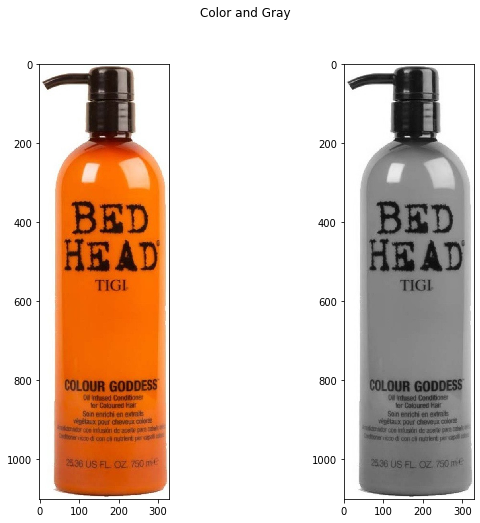

In [271]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(10,8))
fig.suptitle('Color and Gray ')
ax1.imshow(img)
ax2.imshow(img_g,'gray')


## Load Images Function 

Here is the list of actions performed by this function:
   * load all images matrix 
 
   
Parameters :
   * list_of_path : list containing all the paths of our images
   * gray : Boolean, if true, load all image in grayscale, otherwise load them in color (default = True)
   * resize : Boolean, if true resize image into 224 per 224 pixels (default = False)

In [37]:
def load_images(list_of_path, gray=True, resize=False): 
    images = []
    
    if gray==True:
        for i in range(len(list_of_path)):
            path = "./Images/" + list_of_path[i]
            images.append(cv2.imread(path,cv2.IMREAD_GRAYSCALE))
    else:
        for i in range(len(list_of_path)):
            path = "./Images/" + list_of_path[i]
            img = cv2.imread(path)
            img =cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
            
            if resize==True:
                img = cv2.resize(img, dsize=(224,224))

            images.append(img)


    return images
        
        

In [38]:
train_loaded = load_images(train['image'])

In [152]:
# Observ average height and width of our images (in pixels)

hmean = 0
wmean = 0 
for i in range(len(train_loaded)):
    hmean += train_loaded[i].shape[0]
    wmean += train_loaded[i].shape[1]
hmean /=len(train_loaded)
wmean /= len(train_loaded) 

print('Mean Height: {}, mean width: {}'.format(hmean,wmean))

Mean Height: 1222.8244047619048, mean width: 1206.638392857143


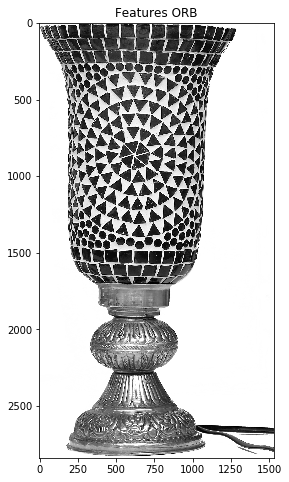

In [39]:
plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(train_loaded[0],'gray')
plt.show()

# ORB Method

## Preprocessing Steps

Number of Keypoints: 500


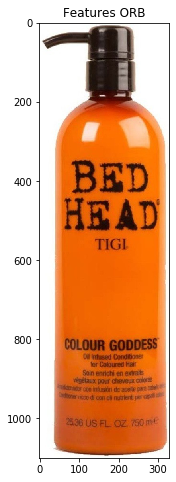

In [152]:
orb = cv2.ORB_create(nfeatures=500)

test_im = cv2.resize(img,dsize=(int(img.shape[1]),int(img.shape[0])))


plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(test_im)
plt.show()



### Gray 

Number of Keypoints: 2870


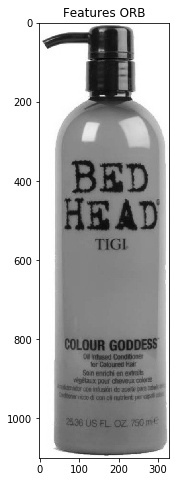

In [272]:
orb = cv2.ORB_create(nfeatures=3000)

test_im = cv2.resize(img_g,dsize=(int(img_g.shape[1]),int(img_g.shape[0])))


plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(test_im,'gray')
plt.show()


### Equalized

We want to Equalize our images so as to smooth a little contrast to help with the keypoints obersvation

In [139]:
# Observe pixel gray intensity distribution before equalizing

hist, bins = np.histogram(test_im.flatten(), 256, [0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * hist.max() / cdf.max()

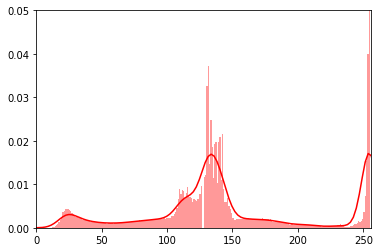

In [285]:
plt.figure(figsize=(6,4))
sns.distplot(test_im.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.ylim([0,0.05])
plt.show()

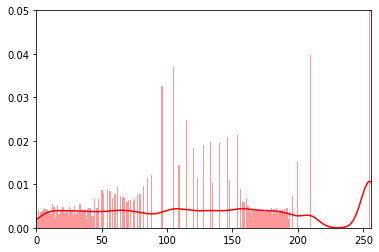

In [286]:
equaliazed = cv2.equalizeHist(test_im)

# Observe pixel gray intensity distribution before equalizing

hist, bins = np.histogram(equaliazed.flatten(), 256, [0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * hist.max() / cdf.max()

plt.figure(figsize=(6,4))
sns.distplot(equaliazed.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.ylim([0,0.05])
plt.show()

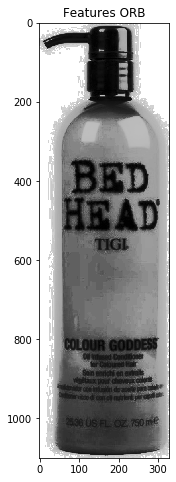

In [290]:
plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(equaliazed,'gray')
plt.show()

Number of Keypoints: 2767


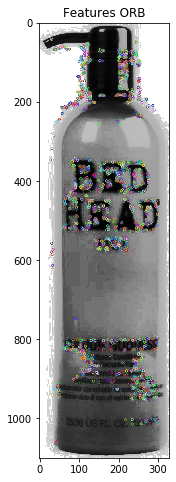

In [288]:
orb = cv2.ORB_create(nfeatures=3000)


#find keypoints and descriptors
kp, des = orb.detectAndCompute(equaliazed, None)
#draw only keypoints location, not size and orientation:
image_orb = cv2.drawKeypoints(equaliazed, kp, None )
print('Number of Keypoints:',len(kp))

plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(image_orb)
plt.show()

### Gaussian Filter

Let's try a couple of filters, here gaussian and median filters (we will let GridSearchCV decide later which one gives the best results)

In [299]:
blur = cv2.GaussianBlur(test_im,(5,5),3)

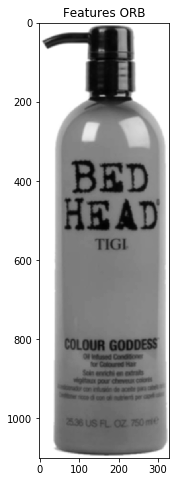

In [300]:
plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(blur,'gray')
plt.show()

Number of Keypoints: 1781


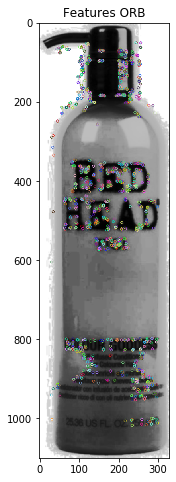

In [260]:
orb = cv2.ORB_create(nfeatures=3000)


#find keypoints and descriptors
kp, des = orb.detectAndCompute(blur, None)
#draw only keypoints location, not size and orientation:
image_orb = cv2.drawKeypoints(blur, kp, None )
print('Number of Keypoints:',len(kp))

plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(image_orb)
plt.show()

### Median Filter

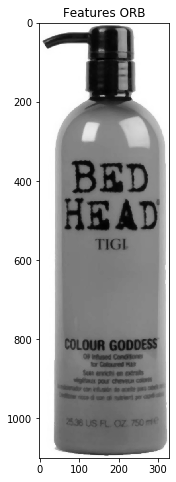

In [301]:
median = cv2.medianBlur(test_im,5)
plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(median,'gray')
plt.show()

Number of Keypoints: 1997


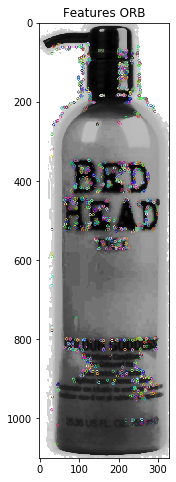

In [305]:
median = cv2.medianBlur(im2,5)
orb = cv2.ORB_create(nfeatures=3000)


#find keypoints and descriptors
kp, des = orb.detectAndCompute(median, None)
#draw only keypoints location, not size and orientation:
image_orb = cv2.drawKeypoints(median, kp, None )
print('Number of Keypoints:',len(kp))

plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(image_orb)
plt.show()

### PreProcessing Function 

Create a first preprocessing function which apply Gaussian Blur, Equalization and Resize our image

In [129]:
def preprocessing_func(image,width,height):
        
    #Gaussian Blur
    im = cv2.GaussianBlur(image,(5,5),0)    
    #Equalize
    im = cv2.equalizeHist(im)
    
    #Resize
    im = cv2.resize(im, dsize=(width,height))
    return im
    

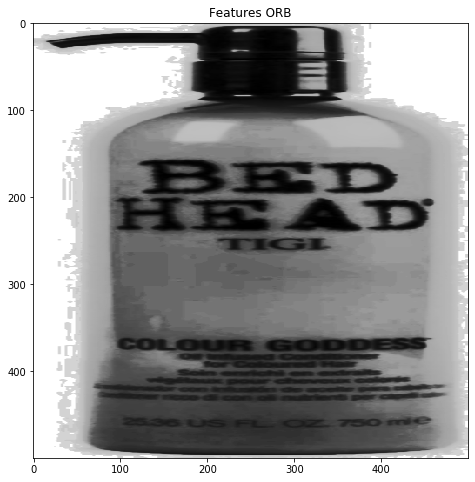

In [272]:
plt.figure(figsize=(10,8))
plt.title('Features ORB')
plt.imshow(preprocessing_func(img_g,500,500),'gray')
plt.show()

In [132]:
train_preprocessed=[]
for i in range(len(train_loaded)):
    train_preprocessed.append(preprocessing_func(train_loaded[i],500,500))


### Find Descriptors function

Create a function which take in parameters our list of preprocessed images and the number max of keypoint we want to observ, and return the list of ORB's descripters

In [134]:
def find_descriptor(preprocessed_img_list,nb_keypoints):
    list_of_desc=[]
    orb = cv2.ORB_create(nfeatures=nb_keypoints)
    
    for i in range(len(preprocessed_img_list)):
        kp, des = orb.detectAndCompute(preprocessed_img_list[i], None)
        list_of_desc.append(des)
    
    return list_of_desc

In [135]:
train_desc=find_descriptor(train_preprocessed,500)

In [36]:
len(train_desc[3])

500

In [12]:
train_desc[2]

array([[116, 164, 241, ..., 225, 198,  99],
       [116, 167, 249, ..., 243, 198,  99],
       [196, 124, 147, ..., 113,   6,  42],
       ...,
       [ 67, 158, 121, ..., 193,  97,  49],
       [107, 182, 113, ..., 132, 195, 117],
       [162,  42, 232, ...,  76, 222, 222]], dtype=uint8)

## First Kmeans (without optimizing parameters)

The goal here is to look at all our keypoints descripters and create some cluster on descripters which are "close" to each other, which will be called "visual word"

In [136]:
train_desc

[array([[ 70,  41, 214, ..., 161,  99,   1],
        [ 98, 232, 224, ..., 153, 114, 136],
        [214,  55, 118, ..., 163, 199,  23],
        ...,
        [ 37, 224, 222, ..., 179, 106,  48],
        [ 28, 206,   5, ..., 187, 164, 176],
        [209,   3,  29, ..., 136, 141,   0]], dtype=uint8),
 array([[ 17, 159, 123, ..., 136, 181, 249],
        [171,  26, 102, ...,  12, 124, 223],
        [ 74,  30, 230, ...,  92,  61, 223],
        ...,
        [  3, 155, 106, ...,   2,  41, 251],
        [ 62,  52,  81, ...,  75,   5,  51],
        [ 11, 159,  35, ..., 140,  53, 253]], dtype=uint8),
 array([[116, 164, 241, ..., 225, 198,  99],
        [ 69, 125, 251, ..., 243,  99, 187],
        [190,  48, 120, ..., 165,  71, 242],
        ...,
        [210,  76, 223, ..., 113,  37,  10],
        [ 45, 187, 249, ..., 171, 208, 241],
        [122, 100, 226, ..., 245, 238,  78]], dtype=uint8),
 array([[ 59, 141,  71, ..., 158, 248,  92],
        [ 16, 201,  19, ...,  26, 181, 170],
        [ 33, 12

In [137]:
# Concatenate all keypoints, so as to obtain a unique list of all our keypoints

test_df = train_desc[0]
for i in range(1,len(train_desc)):
    test_df=np.concatenate((test_df,train_desc[i]))



In [44]:
test_df.shape

(415458, 32)

In [138]:
std = StandardScaler()
kp_scaled = std.fit_transform(test_df)

In [47]:
#Try to find the best number of cluster (visual words) with looking a their silhouette score

import time

print('Kmeans analysis start\n________________')
now = time.asctime()
print(now)

summary_silhouettes=pd.DataFrame()
silhouettes=[]

# Create a loop of to observ the result for each number of clusters chosen
for i in range(2,50):
    cls= cluster.KMeans(n_clusters=i)
    cls.fit(kp_scaled)
    silh= metrics.silhouette_score(kp_scaled,cls.labels_)
    silhouettes.append(silh)
    
    now = time.asctime()
    print('Kmeans {} clusters ({}/{}), done :\n{}\n'.format(i,i-1,48,now))
    
    

summary_silhouettes['sil']=silhouettes
# silhouettes=[]

summary_silhouettes
print('Kmeans analysis end\n________________')


Kmeans analysis start
________________
Fri Sep 18 18:17:29 2020
Kmeans 2 clusters (1/48), done :
Fri Sep 18 19:00:41 2020

Kmeans 3 clusters (2/48), done :
Fri Sep 18 19:42:09 2020

Kmeans 4 clusters (3/48), done :
Fri Sep 18 20:24:21 2020

Kmeans 5 clusters (4/48), done :
Fri Sep 18 21:05:21 2020

Kmeans 6 clusters (5/48), done :
Fri Sep 18 21:46:20 2020

Kmeans 7 clusters (6/48), done :
Fri Sep 18 22:33:35 2020

Kmeans 8 clusters (7/48), done :
Fri Sep 18 23:16:37 2020

Kmeans 9 clusters (8/48), done :
Fri Sep 18 23:57:58 2020

Kmeans 10 clusters (9/48), done :
Sat Sep 19 00:39:16 2020

Kmeans 11 clusters (10/48), done :
Sat Sep 19 01:20:20 2020

Kmeans 12 clusters (11/48), done :
Sat Sep 19 02:01:33 2020

Kmeans 13 clusters (12/48), done :
Sat Sep 19 02:42:41 2020

Kmeans 14 clusters (13/48), done :
Sat Sep 19 03:23:55 2020

Kmeans 15 clusters (14/48), done :
Sat Sep 19 04:05:14 2020

Kmeans 16 clusters (15/48), done :
Sat Sep 19 04:46:44 2020

Kmeans 17 clusters (16/48), done :
Sat

In [49]:
summary_silhouettes

,sil
0,0.071862
1,0.066046
2,0.064403
3,0.065659
4,0.065571
5,0.063184
6,0.055772
7,0.055705
8,0.055865
9,0.054692


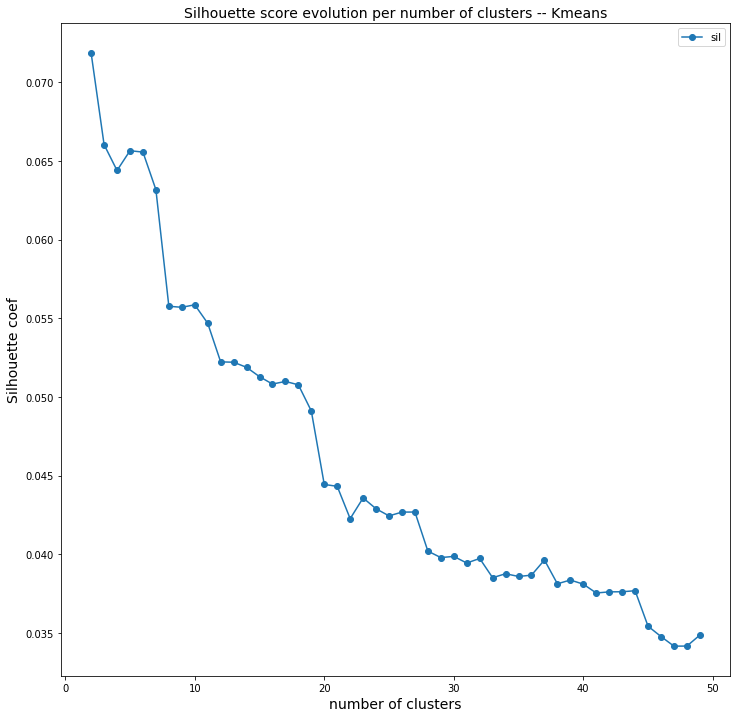

In [48]:
# Plot the result obtained above 
plt.figure(figsize=[12,12])
for col in summary_silhouettes.columns:
    plt.plot(range(2,50),summary_silhouettes[col],marker='o',label=col)
plt.title('Silhouette score evolution per number of clusters -- Kmeans',fontsize=14)
plt.xlabel('number of clusters',fontsize=14)
plt.ylabel('Silhouette coef',fontsize=14)
plt.legend()


Silhouette score doesn't really provides use with interesting results (good silhouette score is with very low number of visual words, it would not be "enough" to correctly help us recognize groups of alike images)
___
Let's try with 20 clusters

In [139]:
cls20 = cluster.KMeans(n_clusters=20)
cls20.fit(kp_scaled)

KMeans(n_clusters=20)

Create a function which return a bag of visual words out of descripters

In [141]:
def bovw_creator(train_descriptors,model_clust,model_scaler):
    
    bovw= pd.DataFrame(columns=list(range(model_clust.cluster_centers_.shape[0])),
                       index=list(range(len(train_descriptors))))
    
    
    for i in range(len(train_descriptors)):
        a=model_scaler.transform(train_desc[i])
        b=pd.Series(model_clust.predict(a))
        c= b.value_counts().sort_index(ascending=True)
        
        for j in range(len(c)):
            bovw.iloc[i,c.index[j]]=c.values.tolist()[j]
            
    bovw.fillna(value=0,inplace=True)
    return bovw
        
    

In [144]:
train_bovw = bovw_creator(train_desc,cls20,std)
train_bovw

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,32,26,34,11,7,8,9,15,43,20,29,29,15,58,28,29,33,28,18,28
1,17,7,39,6,37,12,0,42,20,55,16,39,46,13,43,18,13,11,2,64
2,27,2,20,6,31,4,4,33,28,70,27,5,39,17,42,14,17,49,6,59
3,11,7,27,10,13,13,2,23,17,50,25,24,34,25,38,26,17,48,15,75
4,35,11,37,8,17,1,4,26,20,19,18,18,42,76,20,56,26,58,0,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
835,39,1,11,6,43,11,14,40,32,37,21,7,52,21,21,25,28,28,2,35
836,27,83,11,39,8,15,12,31,35,21,30,28,34,7,39,8,24,17,3,28
837,24,5,31,25,37,12,10,25,23,32,25,13,16,23,24,29,49,41,5,51
838,49,9,29,10,22,9,6,40,24,18,64,19,20,25,34,24,34,30,9,25


Here is the list of actions performed by this function:
   
   * load all images matrix 
   * preprocess them 
   * find its keypoints and descriptors
   * create a bag of visual words for each image out of the previous descriptors
 
   
Parameters :
   * data : dataset containing images path in "image" column
   * model_clust : clustering model 
   * model_scaler : standardscaler model
   * nb_desc : max number of keypoints per image
   * h : heigth of picture
   * w: width of picture

In [147]:
def predict_bovw(data,model_clust,model_scaler,nb_desc,w,h):
    data_loaded = load_images(data)
    
    data_preprocessed=[]
    for i in range(len(data_loaded)):
        data_preprocessed.append(preprocessing_func(data_loaded[i],w,h))
        
    data_desc=find_descriptor(data_preprocessed,nb_desc)
    
    data_bovw = bovw_creator(data_desc,model_clust,model_scaler)
    
    return data_bovw

In [148]:
test_bovw = predict_bovw(test.image,cls20,std,500,500,500)
test_bovw

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,32,26,34,11,7,8,9,15,43,20,29,29,15,58,28,29,33,28,18,28
1,17,7,39,6,37,12,0,42,20,55,16,39,46,13,43,18,13,11,2,64
2,27,2,20,6,31,4,4,33,28,70,27,5,39,17,42,14,17,49,6,59
3,11,7,27,10,13,13,2,23,17,50,25,24,34,25,38,26,17,48,15,75
4,35,11,37,8,17,1,4,26,20,19,18,18,42,76,20,56,26,58,0,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205,21,4,23,10,3,10,3,21,29,87,8,34,40,19,39,35,13,36,13,52
206,36,3,32,7,18,6,4,30,20,33,41,13,34,26,39,40,46,27,4,41
207,14,11,65,9,14,13,2,39,20,30,16,20,25,34,23,55,23,31,23,33
208,28,8,35,5,8,12,7,40,38,33,54,42,13,16,39,41,30,24,3,24


### RandomForest

In [153]:
parameters = {"n_estimators": [100,150,200],  #Number of tree to build
              "max_depth": np.linspace(10, 110, num = 4),   # Max depth of the tree
              "min_samples_leaf": [1,3,5],#min amount of sample to have both left and right to a node
              "max_features":['auto', 'sqrt'] # additionnal source of random (max feature available 
                                                                     # when looking at feature for best split)
             } 

# tfidf_rfr_pipe = make_pipeline(TfidfVectorizer(encoding='utf-8',
#                                                lowercase=True),
#                              RandomForestClassifier())

img_rfr_grid = GridSearchCV(estimator = RandomForestClassifier(), 
                              param_grid = parameters,
                              scoring ='accuracy' ,
                              cv=5)

img_rfr_grid.fit(train_bovw, train.category)

img_classifier = img_rfr_grid.best_estimator_


print('Validation Score (accuracy): ',img_rfr_grid.best_score_)

print('\nBest Params: ',img_rfr_grid.best_params_)

print('\nTest Score (accuracy): ',accuracy_score(test.category,img_classifier.predict(test_bovw)))


Validation Score (accuracy):  0.36309523809523814

Best Params:  {'max_depth': 43.333333333333336, 'max_features': 'auto', 'min_samples_leaf': 1, 'n_estimators': 200}

Test Score (accuracy):  0.1380952380952381


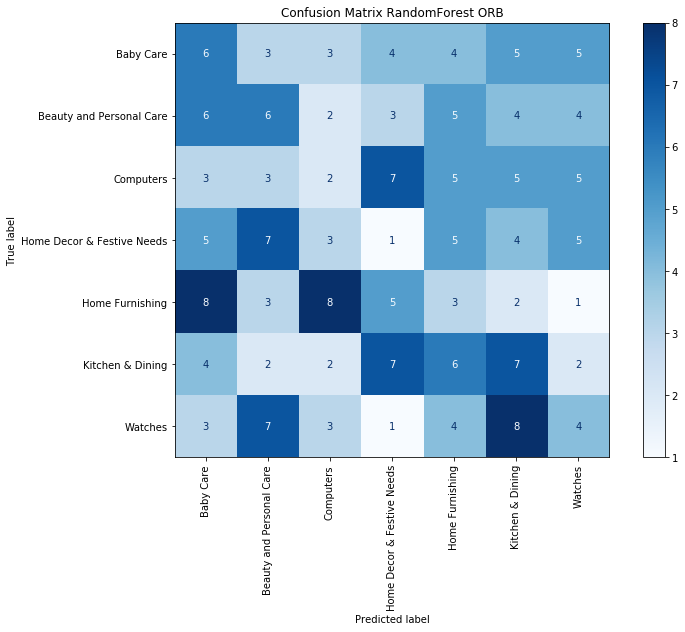

In [154]:
fig, ax = plt.subplots(figsize=(12, 8))

plot_confusion_matrix(img_classifier,
                      test_bovw,
                      test.category,
                      ax=ax,
                      xticks_rotation=90,
                      cmap='Blues')  

ax.set_title('Confusion Matrix RandomForest ORB')
plt.show() 

The first results are quite disappointing, we will need to improve our parameters

## Try ORB method with optimization 

Let's create 2 transformers (one for the preprocessing, one for the bovw creation) so that we can pass their parameters in GridSearchCV Optimization

### Preprocessing Transformers 

Here are a few information concerning the following "ImagePreprocessor" class: 
   
Class inheritance :
   * TransformerMixin (so as to get fit_transform function for free)
   * BaseEstimator (so as to get get_params and set_params functions for free)
   
Class Functions :

1) Init
   
   * Init params 
  
    Parameters :
       * kernel : kernel size for gaussian or median blur
       * width and height for the resizing
       * gaussormedian : Boolean, True = perform gaussianblur, False = perform median blur

2) Transform 

   * perform gaussian or median blur, equalization, and resize the picture 

In [178]:
# Creater transformer which inherits from TransformerMixin and BaseEstimator of Sklearn 
# Parameters for now will be kernel, width height, 

class ImagePreprocessor(TransformerMixin, BaseEstimator ):
        #Class Constructor 
        
    def __init__( self, kernel=3, width=500, height=500, gaussormedian=True ):
        self.kernel = kernel 
        self.width = width 
        self.height = height 
        self.gaussormedian = gaussormedian

    #Return self nothing else to do here    
    def fit( self, X, y = None ):
        return self 
    
    #Method that describes what we need this transformer to do
    def transform( self, X, y = None ):
        
        if self.gaussormedian == True:
            _X = [cv2.GaussianBlur(image,(self.kernel,self.kernel),0) for image in X]
        else :
            _X = [cv2.medianBlur(image,self.kernel) for image in X]
        
        _X = [cv2.equalizeHist(image) for image in _X]
        
        _X = [cv2.resize(image, dsize=(self.width,self.height)) for image in _X]
        
        return _X

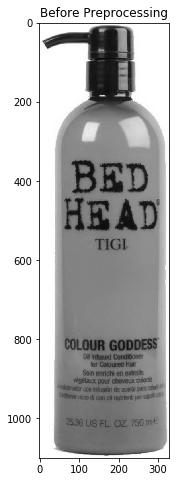

In [158]:
plt.figure(figsize=(10,8))
plt.title('Before Preprocessing')
plt.imshow(train_loaded[2],'gray')
plt.show()

In [165]:
prep = ImagePreprocessor(5,500,500,True)

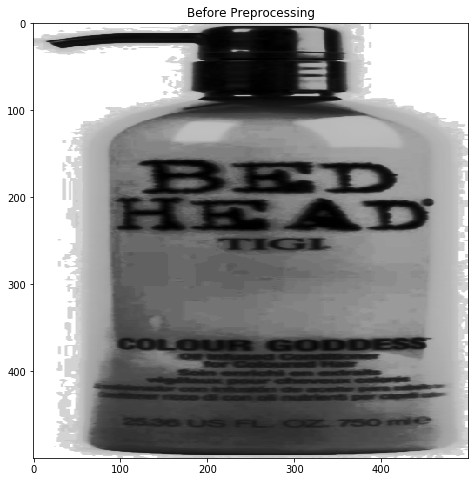

In [166]:
train_prep=prep.fit_transform(train_loaded)
plt.figure(figsize=(10,8))
plt.title('Before Preprocessing')
plt.imshow(train_prep[2],'gray')
plt.show()

### images to bag of virtual word transformer

Here are a few information concerning the following "ImageToBow" class: 
   
Class inheritance :
   * TransformerMixin (so as to get fit_transform function for free)
   * BaseEstimator (so as to get get_params and set_params functions for free)
   
Class Functions :

1) Init
   
   * Init params 
  
    Parameters :
       * nb_keypoints : max number of keypoints per image
       * visual_word : number of cluster to use when doing the clustering part to get the visual words

2) Fit 

   * Train the clustering model on the keypoints descriptors of our train dataset
   
3) Transform 

   * Predict a bag of visual words for the given dataset

In [177]:
class ImagesToBovw(TransformerMixin,BaseEstimator ):
        #Class Constructor 
    def __init__( self, nb_keypoints=500, nb_visual_words=20):
        self.nb_keypoints = nb_keypoints 
        self.nb_visual_words = nb_visual_words 
       
    #setup the clustering method via Kmeans to create the visual words 
    def fit( self, X, y = None ):
        
        list_of_desc=[]
        
        self.orb = cv2.ORB_create(nfeatures=self.nb_keypoints)

        for i in range(len(X)):
            kp, des = self.orb.detectAndCompute(X[i], None)
            list_of_desc.append(des)
            
        concat_desc = list_of_desc[0]
        for i in range(1,len(list_of_desc)):
            concat_desc=np.concatenate((concat_desc,list_of_desc[i]))
        
        self.std = StandardScaler()
        kp_scaled = self.std.fit_transform(concat_desc)

        self.cls = cluster.KMeans(n_clusters=self.nb_visual_words)
        self.cls.fit(kp_scaled)
        
        return self 
    
    #Method that describes what we need this transformer to do
    def transform( self, X, y = None ):
        
        list_of_desc=[]
        
        for i in range(len(X)):
            kp, des = self.orb.detectAndCompute(X[i], None)
            list_of_desc.append(des)
            
        bovw= pd.DataFrame(columns=list(range(self.cls.cluster_centers_.shape[0])),
                           index=list(range(len(list_of_desc))))


        for i in range(len(list_of_desc)):
            a=self.std.transform(list_of_desc[i])
            b=pd.Series(self.cls.predict(a))
            c= b.value_counts().sort_index(ascending=True)

            for j in range(len(c)):
                bovw.iloc[i,c.index[j]]=c.values.tolist()[j]

        bovw.fillna(value=0,inplace=True)        
        
        return bovw

In [168]:
bovw_obj = ImagesToBovw(500,20)

In [169]:
bovw_train=bovw_obj.fit_transform(train_prep)
bovw_train

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,9,33,30,29,19,27,7,61,12,8,41,28,17,24,16,16,20,46,33,24
1,3,19,53,13,3,9,0,13,14,31,24,24,51,15,56,59,22,37,9,45
2,8,25,59,17,6,3,4,19,5,30,25,18,30,49,37,63,32,19,11,40
3,10,10,70,13,14,7,2,26,14,14,12,33,36,40,28,52,31,30,11,47
4,9,20,8,34,0,12,4,66,2,16,21,63,28,58,45,19,18,42,22,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
835,7,31,39,23,2,1,16,23,5,41,36,28,35,27,53,29,27,12,21,18
836,41,34,34,21,4,82,12,5,16,11,43,9,20,22,39,16,28,12,14,37
837,25,26,50,50,5,5,11,21,14,36,17,34,28,39,16,32,24,27,18,22
838,10,24,27,52,8,9,6,29,8,22,30,18,32,29,20,19,60,27,37,33


### Pipeline Creation (with RandomForest) + Gridsearch 

In [189]:
import time
print('GridSearch start\n________________')
now = time.asctime()
print(now,'\n')

parameters = {"imagepreprocessor__kernel":[3,5], #kernel to use
              "imagepreprocessor__gaussormedian":[True,False], #GaussianBlur or MedianBlur
              "imagestobovw__nb_keypoints":[500,800], #nb max of keypoints per image
              "imagestobovw__nb_visual_words":[20,30]} #nb of visual words to use for classification
#               "randomforestclassifier__n_estimators": [100,150,200],  #Number of tree to build
#               "randomforestclassifier__max_depth": np.linspace(10, 110, num = 4),   # Max depth of the tree
#               "randomforestclassifier__min_samples_leaf": [1,3,5],#min amount of sample to have both left and right to a node
#               "randomforestclassifier__max_features":['auto', 'sqrt'] # additionnal source of random (max feature available 
#                                                                      # when looking at feature for best split)
#              } 

image_rfr_pipe = make_pipeline(ImagePreprocessor(width=500,
                                               height=500),
                             ImagesToBovw(),
                             RandomForestClassifier(n_estimators=150,
                                                    max_depth=50,
                                                    min_samples_leaf=1,
                                                    max_features='auto'))

image_rfr_grid = GridSearchCV(estimator = image_rfr_pipe, 
                              param_grid = parameters,
                              scoring ='accuracy' ,
                              cv=5,
                              verbose=1)

image_rfr_grid.fit(load_images(train['image']), train.category)

image_classifier = image_rfr_grid.best_estimator_


print('Validation Score (accuracy): ',image_rfr_grid.best_score_)

print('\nBest Params: ',image_rfr_grid.best_params_)

print('\nTest Score (accuracy): ',accuracy_score(test.category,image_classifier.predict(load_images(test['image']))))

print('\n\nGridSearch done\n________________')
now = time.asctime()
print(now,'\n')

GridSearch start
________________
Wed Sep 23 01:29:21 2020 

Fitting 5 folds for each of 16 candidates, totalling 80 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  80 out of  80 | elapsed: 218.7min finished


Validation Score (accuracy):  0.3928571428571428

Best Params:  {'imagepreprocessor__gaussormedian': False, 'imagepreprocessor__kernel': 3, 'imagestobovw__nb_keypoints': 800, 'imagestobovw__nb_visual_words': 30}

Test Score (accuracy):  0.35714285714285715


GridSearch done
________________
Wed Sep 23 05:13:44 2020 



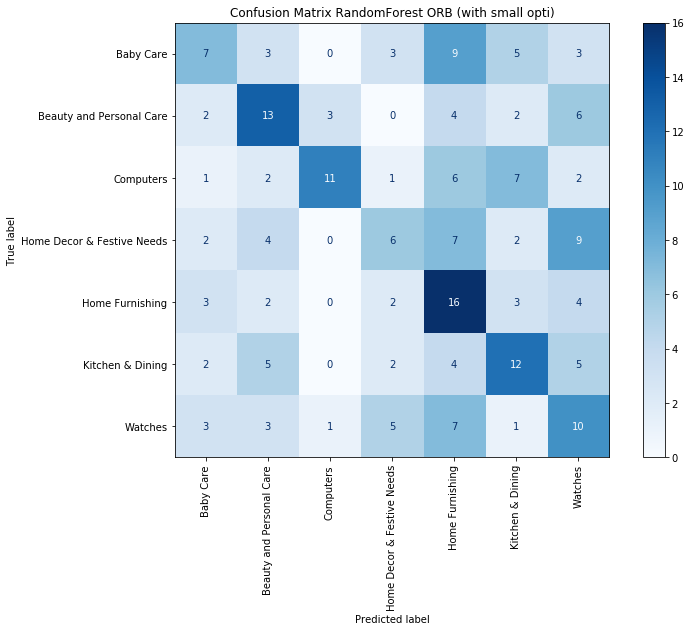

In [190]:
fig, ax = plt.subplots(figsize=(12, 8))

plot_confusion_matrix(image_classifier,
                      load_images(test['image']),
                      test.category,
                      ax=ax,
                      xticks_rotation=90,
                      cmap='Blues')  

ax.set_title('Confusion Matrix RandomForest ORB (with small opti)')
plt.show() 

# CNN Methods

## Keras VGG-16  Transfer Learning

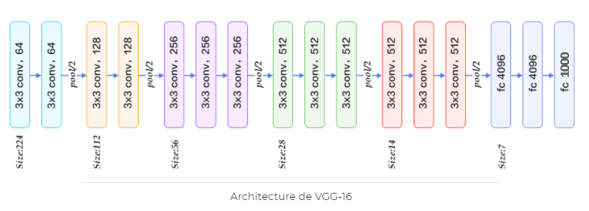

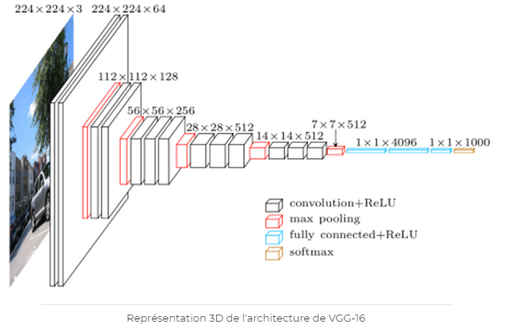

### Load Model

In [312]:
# load VGG16
model = VGG16(include_top=True, input_shape=(224, 224, 3))
model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [32]:
# Set the layers of the loaded model as non-trainable so that we do not lose the pre-training done on VGG16
# with 14 million of image from imagenet 

for layer in model.layers:
    layer.trainable = False

# add new classifier layers
    
# Keep all layer except from the last one which is specific to the original problematic of VGG16
flat1 = Flatten()(model.layers[-2].output)

# add new classifier layers for 7 categories
output = Dense(7, activation='softmax')(flat1)
# define new model
new_model = Model(inputs=model.inputs, outputs=output)
# summarize
new_model.summary()

Model: "functional_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)     

### Load + Preprocess images

Here is the list of actions performed by this function:
   
   * load all images matrix with resizing them into 224x224 matrix 
   * convert it into numpy array
   * change it into correct dimension array => (nb_image,224,224,3)
   * apply the VGG16 preprocessing
 
   
Parameters :
   * list_of_path : list of all images paths


In [8]:
def load_keras(list_of_path):
    
    for i in range(len(list_of_path)):
        if i ==0:
            path = "./Images/" + list_of_path[i]
            img = load_img(path, target_size=(224, 224))  # Charger l'image
            img = img_to_array(img)  # Convertir en tableau numpy
            img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))  # Créer la collection d'images (un seul échantillon)
            img = preprocess_input(img)  # Prétraiter l'image comme le veut VGG-16
        else: 
            path = "./Images/" + list_of_path[i]
            im = load_img(path, target_size=(224, 224))  # Charger l'image
            im = img_to_array(im)  # Convertir en tableau numpy
            im = im.reshape((1, im.shape[0], im.shape[1], im.shape[2]))  # Créer la collection d'images (un seul échantillon)
            im = preprocess_input(im)  # Prétraiter l'image comme le veut VGG-16
            img = np.concatenate((img, im), axis=0)
    
    return img
        


In [35]:
# Split train set into train + validation sets (so as to use EarlyStopping later when training the neural network)

train,validation = train_test_split(train,
                                    test_size=0.20,
                                    stratify=train.category)
train=train.reset_index()
validation=validation.reset_index()

In [58]:
train.shape

(672, 4)

In [55]:
train.category.value_counts()

Baby Care                     77
Home Decor & Festive Needs    77
Home Furnishing               77
Computers                     77
Watches                       77
Kitchen & Dining              76
Beauty and Personal Care      76
Name: category, dtype: int64

In [8]:
validation.category.value_counts()

Kitchen & Dining              24
Home Decor & Festive Needs    24
Beauty and Personal Care      24
Home Furnishing               24
Computers                     24
Watches                       24
Baby Care                     24
Name: category, dtype: int64

In [36]:
# Load train and validation in correct keras VGG16 format

train_keras = load_keras(train.image)
validation_keras = load_keras(validation.image)
train_keras.shape

C:\Users\quent\anaconda3\lib\site-packages\PIL\Image.py:2766: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


(672, 224, 224, 3)

In [303]:
train_keras.shape

(840, 224, 224, 3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


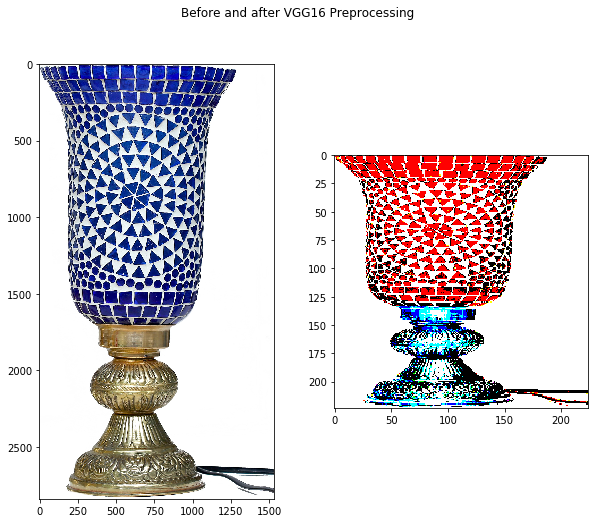

In [309]:
# Overview of VGG16 preprocessing

fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(10,8))
fig.suptitle('Before and after VGG16 Preprocessing ')
ax1.imshow(img)
ax2.imshow(train_keras[0])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


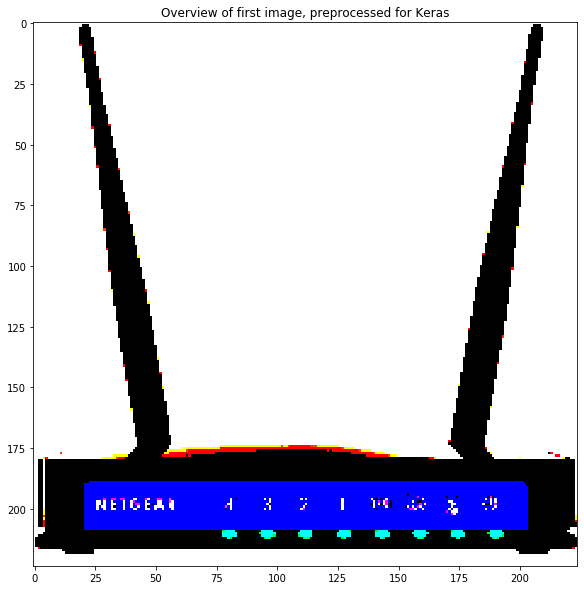

In [39]:
plt.figure(figsize=(10,10))
plt.title('Overview of first image, preprocessed for Keras')
plt.imshow(train_keras[1])
plt.show()

In [37]:
# Turn target into ohe features (so that VGG16 can interpret them)

ohe = OneHotEncoder(handle_unknown='ignore')
y_train = ohe.fit_transform(np.array(train.category).reshape(-1,1)).todense()
y_val = ohe.transform(np.array(validation.category).reshape(-1,1)).todense()

In [38]:
y_train.shape

(672, 7)

### Assess Model Performances

In [264]:
# Compile model
new_model.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

# Train it on our training set (X_train, y_train)
model_info = new_model.fit(train_keras, y_train, epochs=5, batch_size=50, verbose=2)


Epoch 1/5
17/17 - 225s - loss: 1.1432 - accuracy: 0.6690
Epoch 2/5
17/17 - 224s - loss: 0.3981 - accuracy: 0.8869
Epoch 3/5
17/17 - 227s - loss: 0.1688 - accuracy: 0.9500
Epoch 4/5
17/17 - 221s - loss: 0.0945 - accuracy: 0.9750
Epoch 5/5
17/17 - 223s - loss: 0.0527 - accuracy: 0.9929


In [270]:
# Predict categories so as to have a first preview of model accuracy 

train_keras_pred = new_model.predict(train_keras)

test_keras = load_keras(test.image)
y_test = ohe.transform(np.array(test.category).reshape(-1,1)).todense()

test_keras_pred = new_model.predict(test_keras)


In [271]:
# Compare predicted category with actual category 

print('Train Score (accuracy): ',accuracy_score(np.argmax(train_keras_pred, axis=1).reshape(-1,1), 
                                                np.argmax(y_train, axis=1).reshape(-1,1)))


print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))


Train Score (accuracy):  0.9988095238095238

Test Score (accuracy):  0.8380952380952381


Text(0.5, 51.0, 'Predicted Label')

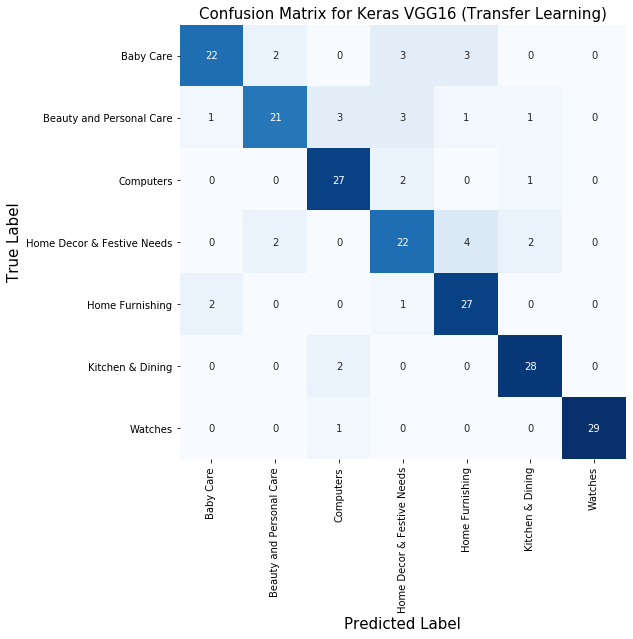

In [304]:
# Print Confusion Matrix 

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning)',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)


In [286]:
list(ohe.categories_[0])

['Baby Care',
 'Beauty and Personal Care',
 'Computers',
 'Home Decor & Festive Needs',
 'Home Furnishing',
 'Kitchen & Dining',
 'Watches']

### Use Validation Early Stopping

In order to prevent our model from overfitting, we will setup an earlystopping based on a validation set 

In [16]:
test_keras = load_keras(test.image)
y_test = ohe.transform(np.array(test.category).reshape(-1,1)).todense()

#### Batch Size: 50 

In [40]:
flat1 = Flatten()(model.layers[-2].output)
output = Dense(7, activation='softmax')(flat1)
# define new model
new_model50 = Model(inputs=model.inputs, outputs=output)

In [41]:
#Create a monitor for EarlyStopping
monitor=EarlyStopping(monitor='val_loss',
                      min_delta=1e-3,
                      patience=5,
                      verbose=2,
                      restore_best_weights=True)

# Compiler le modèle 
new_model50.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

# Entraîner sur les données d'entraînement (X_train, y_train)
model_info = new_model50.fit(train_keras,
                           y_train,
                           callbacks=monitor,
                           validation_data=(validation_keras,y_val),
                           epochs=30,
                           batch_size=50,
                           verbose=2)

Epoch 1/30
14/14 - 222s - loss: 1.4797 - accuracy: 0.5759 - val_loss: 0.6434 - val_accuracy: 0.8274
Epoch 2/30
14/14 - 217s - loss: 0.4373 - accuracy: 0.8720 - val_loss: 0.5330 - val_accuracy: 0.8393
Epoch 3/30
14/14 - 216s - loss: 0.1982 - accuracy: 0.9420 - val_loss: 0.4989 - val_accuracy: 0.8512
Epoch 4/30
14/14 - 219s - loss: 0.1167 - accuracy: 0.9673 - val_loss: 0.5245 - val_accuracy: 0.8393
Epoch 5/30
14/14 - 218s - loss: 0.0597 - accuracy: 0.9911 - val_loss: 0.4848 - val_accuracy: 0.8512
Epoch 6/30
14/14 - 216s - loss: 0.0383 - accuracy: 0.9985 - val_loss: 0.4921 - val_accuracy: 0.8393
Epoch 7/30
14/14 - 214s - loss: 0.0294 - accuracy: 1.0000 - val_loss: 0.4886 - val_accuracy: 0.8393
Epoch 8/30
14/14 - 215s - loss: 0.0219 - accuracy: 1.0000 - val_loss: 0.4682 - val_accuracy: 0.8452
Epoch 9/30
14/14 - 216s - loss: 0.0169 - accuracy: 1.0000 - val_loss: 0.4703 - val_accuracy: 0.8512
Epoch 10/30
14/14 - 216s - loss: 0.0143 - accuracy: 1.0000 - val_loss: 0.4830 - val_accuracy: 0.8571


Test Score (accuracy):  0.8333333333333334
_______________________________________________


Text(0.5, 51.0, 'Predicted Label')

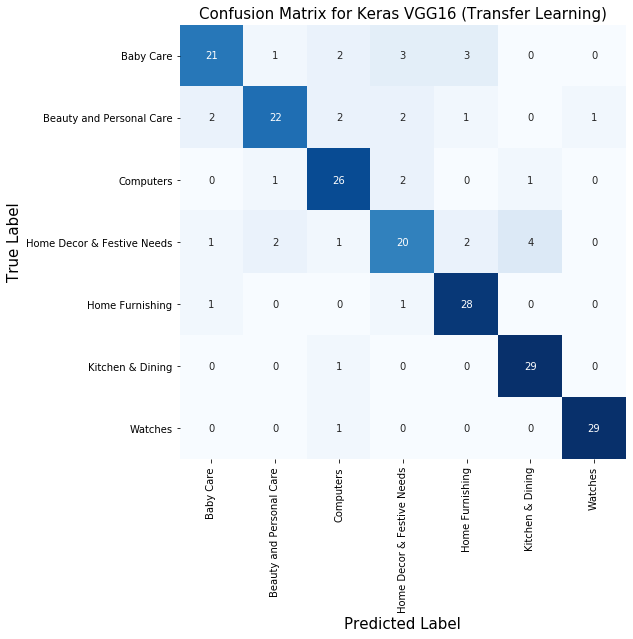

In [42]:
test_keras_pred = new_model50.predict(test_keras)
print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))
print('_______________________________________________')

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning)',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)

#### Batch Size: 30

In [43]:
flat1 = Flatten()(model.layers[-2].output)
# class1 = Dense(512, activation='relu')(flat1)
output = Dense(7, activation='softmax')(flat1)
# define new model
new_model30 = Model(inputs=model.inputs, outputs=output)

In [44]:
from keras.callbacks import EarlyStopping

import time


now = time.asctime()
print(now,'\n')


#Create a monitor for EarlyStopping
monitor=EarlyStopping(monitor='val_loss',
                      min_delta=1e-3,
                      patience=5,
                      verbose=2,
                      restore_best_weights=True)

# Compiler le modèle 
new_model30.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

# Entraîner sur les données d'entraînement (X_train, y_train)
model_info = new_model30.fit(train_keras,
                           y_train,
                           callbacks=monitor,
                           validation_data=(validation_keras,y_val),
                           epochs=30,
                           batch_size=30,
                           verbose=2)

now = time.asctime()
print(now,'\n')


Fri Sep 25 16:00:00 2020 

Epoch 1/30
23/23 - 218s - loss: 1.1078 - accuracy: 0.6801 - val_loss: 0.7288 - val_accuracy: 0.7976
Epoch 2/30
23/23 - 219s - loss: 0.2877 - accuracy: 0.9092 - val_loss: 0.4836 - val_accuracy: 0.8571
Epoch 3/30
23/23 - 218s - loss: 0.1062 - accuracy: 0.9643 - val_loss: 0.5111 - val_accuracy: 0.8631
Epoch 4/30
23/23 - 217s - loss: 0.0536 - accuracy: 0.9896 - val_loss: 0.4317 - val_accuracy: 0.8512
Epoch 5/30
23/23 - 223s - loss: 0.0283 - accuracy: 0.9985 - val_loss: 0.4727 - val_accuracy: 0.8393
Epoch 6/30
23/23 - 219s - loss: 0.0220 - accuracy: 0.9985 - val_loss: 0.4722 - val_accuracy: 0.8452
Epoch 7/30
23/23 - 221s - loss: 0.0151 - accuracy: 1.0000 - val_loss: 0.4967 - val_accuracy: 0.8512
Epoch 8/30
23/23 - 221s - loss: 0.0114 - accuracy: 1.0000 - val_loss: 0.4685 - val_accuracy: 0.8571
Epoch 9/30
Restoring model weights from the end of the best epoch.
23/23 - 221s - loss: 0.0096 - accuracy: 1.0000 - val_loss: 0.4766 - val_accuracy: 0.8631
Epoch 00009: earl


Test Score (accuracy):  0.8523809523809524
_______________________________________________


Text(0.5, 51.0, 'Predicted Label')

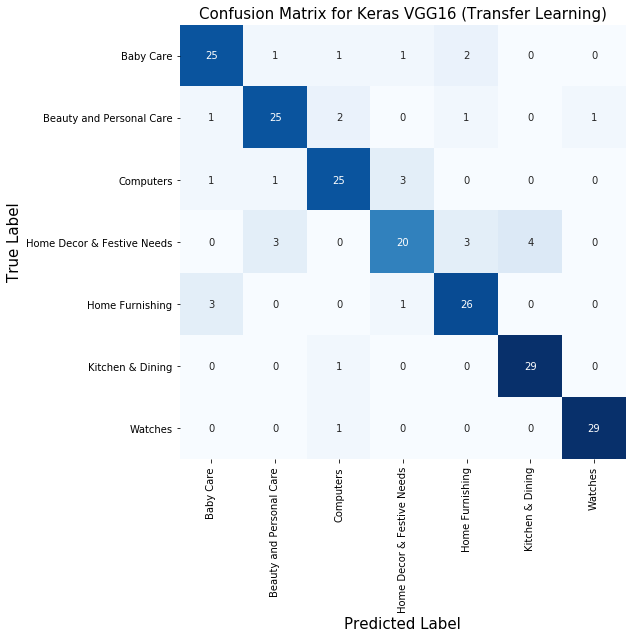

In [45]:
test_keras_pred = new_model30.predict(test_keras)
print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))
print('_______________________________________________')

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning)',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)

#### Batch Size: 60

In [46]:
flat1 = Flatten()(model.layers[-2].output)
# class1 = Dense(512, activation='relu')(flat1)
output = Dense(7, activation='softmax')(flat1)
# define new model
new_model60 = Model(inputs=model.inputs, outputs=output)

In [47]:
from keras.callbacks import EarlyStopping

import time


now = time.asctime()
print(now,'\n')


#Create a monitor for EarlyStopping
monitor=EarlyStopping(monitor='val_loss',
                      min_delta=1e-3,
                      patience=5,
                      verbose=2,
                      restore_best_weights=True)

# Compiler le modèle 
new_model60.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

# Entraîner sur les données d'entraînement (X_train, y_train)
model_info = new_model60.fit(train_keras,
                           y_train,
                           callbacks=monitor,
                           validation_data=(validation_keras,y_val),
                           epochs=30,
                           batch_size=60,
                           verbose=2)

now = time.asctime()
print(now,'\n')


Fri Sep 25 16:35:22 2020 

Epoch 1/30
12/12 - 215s - loss: 1.5011 - accuracy: 0.5774 - val_loss: 0.6949 - val_accuracy: 0.8095
Epoch 2/30
12/12 - 216s - loss: 0.4630 - accuracy: 0.8661 - val_loss: 0.5564 - val_accuracy: 0.8452
Epoch 3/30
12/12 - 215s - loss: 0.2359 - accuracy: 0.9241 - val_loss: 0.5254 - val_accuracy: 0.8452
Epoch 4/30
12/12 - 212s - loss: 0.1259 - accuracy: 0.9628 - val_loss: 0.5340 - val_accuracy: 0.8333
Epoch 5/30
12/12 - 211s - loss: 0.0847 - accuracy: 0.9732 - val_loss: 0.5024 - val_accuracy: 0.8393
Epoch 6/30
12/12 - 214s - loss: 0.0515 - accuracy: 0.9926 - val_loss: 0.5251 - val_accuracy: 0.8333
Epoch 7/30
12/12 - 214s - loss: 0.0318 - accuracy: 0.9970 - val_loss: 0.5081 - val_accuracy: 0.8512
Epoch 8/30
12/12 - 216s - loss: 0.0253 - accuracy: 1.0000 - val_loss: 0.4990 - val_accuracy: 0.8631
Epoch 9/30
12/12 - 216s - loss: 0.0199 - accuracy: 1.0000 - val_loss: 0.5098 - val_accuracy: 0.8571
Epoch 10/30
12/12 - 212s - loss: 0.0173 - accuracy: 1.0000 - val_loss: 0.


Test Score (accuracy):  0.8333333333333334
_______________________________________________


Text(0.5, 51.0, 'Predicted Label')

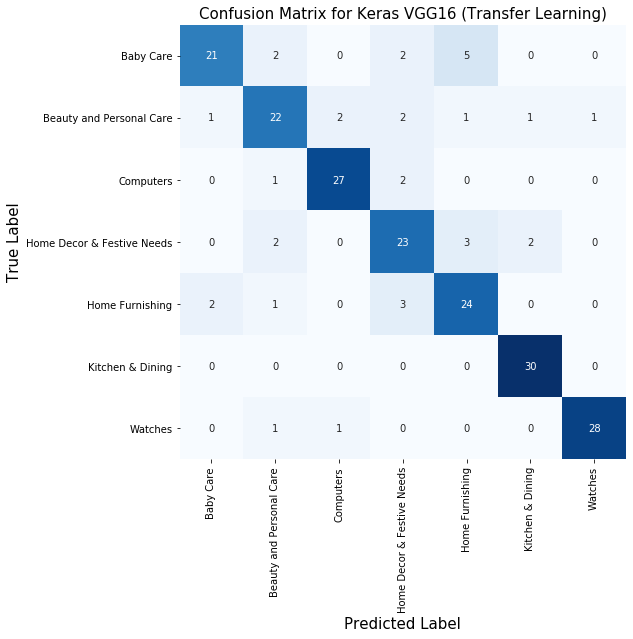

In [48]:
test_keras_pred = new_model60.predict(test_keras)
print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))
print('_______________________________________________')

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning)',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)

#### Batch Size: 20

In [49]:
flat1 = Flatten()(model.layers[-2].output)
# class1 = Dense(512, activation='relu')(flat1)
output = Dense(7, activation='softmax')(flat1)
# define new model
new_model20 = Model(inputs=model.inputs, outputs=output)

In [50]:
from keras.callbacks import EarlyStopping

import time


now = time.asctime()
print(now,'\n')


#Create a monitor for EarlyStopping
monitor=EarlyStopping(monitor='val_loss',
                      min_delta=1e-3,
                      patience=5,
                      verbose=2,
                      restore_best_weights=True)

# Compiler le modèle 
new_model20.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

# Entraîner sur les données d'entraînement (X_train, y_train)
model_info = new_model20.fit(train_keras,
                           y_train,
                           callbacks=monitor,
                           validation_data=(validation_keras,y_val),
                           epochs=30,
                           batch_size=20,
                           verbose=2)

now = time.asctime()
print(now,'\n')


Fri Sep 25 18:00:08 2020 

Epoch 1/30
34/34 - 223s - loss: 1.0423 - accuracy: 0.7083 - val_loss: 0.5250 - val_accuracy: 0.7917
Epoch 2/30
34/34 - 227s - loss: 0.3026 - accuracy: 0.9122 - val_loss: 0.5878 - val_accuracy: 0.8095
Epoch 3/30
34/34 - 225s - loss: 0.1283 - accuracy: 0.9539 - val_loss: 0.5285 - val_accuracy: 0.8333
Epoch 4/30
34/34 - 228s - loss: 0.0452 - accuracy: 0.9896 - val_loss: 0.3948 - val_accuracy: 0.8750
Epoch 5/30
34/34 - 226s - loss: 0.0200 - accuracy: 1.0000 - val_loss: 0.4091 - val_accuracy: 0.8690
Epoch 6/30
34/34 - 224s - loss: 0.0137 - accuracy: 1.0000 - val_loss: 0.4189 - val_accuracy: 0.8690
Epoch 7/30
34/34 - 224s - loss: 0.0102 - accuracy: 1.0000 - val_loss: 0.4028 - val_accuracy: 0.8810
Epoch 8/30
34/34 - 226s - loss: 0.0084 - accuracy: 1.0000 - val_loss: 0.4159 - val_accuracy: 0.8810
Epoch 9/30
Restoring model weights from the end of the best epoch.
34/34 - 225s - loss: 0.0072 - accuracy: 1.0000 - val_loss: 0.4190 - val_accuracy: 0.8750
Epoch 00009: earl


Test Score (accuracy):  0.8333333333333334
_______________________________________________


Text(0.5, 51.0, 'Predicted Label')

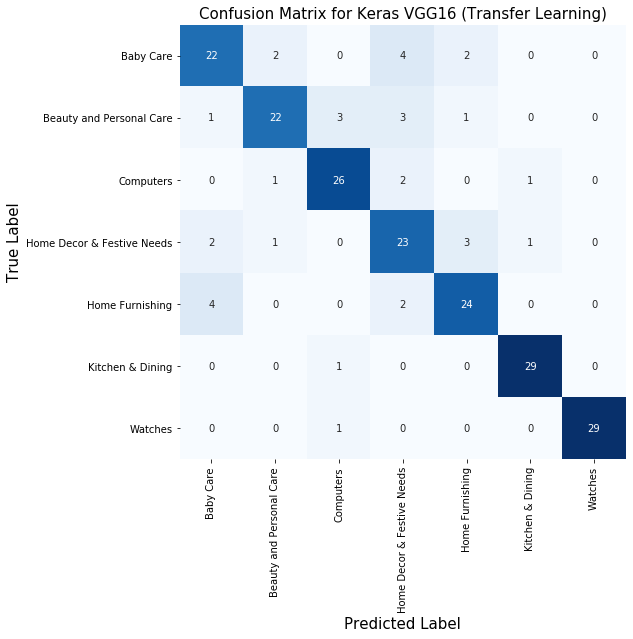

In [51]:
test_keras_pred = new_model20.predict(test_keras)
print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))
print('_______________________________________________')

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning)',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)

#### Batch Size: 10

In [52]:
flat1 = Flatten()(model.layers[-2].output)
# class1 = Dense(512, activation='relu')(flat1)
output = Dense(7, activation='softmax')(flat1)
# define new model
new_model10 = Model(inputs=model.inputs, outputs=output)

In [53]:
from keras.callbacks import EarlyStopping

import time


now = time.asctime()
print(now,'\n')


#Create a monitor for EarlyStopping
monitor=EarlyStopping(monitor='val_loss',
                      min_delta=1e-3,
                      patience=5,
                      verbose=2,
                      restore_best_weights=True)

# Compiler le modèle 
new_model10.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

# Entraîner sur les données d'entraînement (X_train, y_train)
model_info = new_model10.fit(train_keras,
                           y_train,
                           callbacks=monitor,
                           validation_data=(validation_keras,y_val),
                           epochs=30,
                           batch_size=10,
                           verbose=2)

now = time.asctime()
print(now,'\n')


Fri Sep 25 18:35:43 2020 

Epoch 1/30
68/68 - 236s - loss: 1.1283 - accuracy: 0.7128 - val_loss: 0.6387 - val_accuracy: 0.8214
Epoch 2/30
68/68 - 235s - loss: 0.2638 - accuracy: 0.9182 - val_loss: 0.6176 - val_accuracy: 0.8095
Epoch 3/30
68/68 - 233s - loss: 0.0935 - accuracy: 0.9688 - val_loss: 0.5482 - val_accuracy: 0.8155
Epoch 4/30
68/68 - 234s - loss: 0.0294 - accuracy: 0.9940 - val_loss: 0.4756 - val_accuracy: 0.8631
Epoch 5/30
68/68 - 236s - loss: 0.0102 - accuracy: 1.0000 - val_loss: 0.4970 - val_accuracy: 0.8690
Epoch 6/30
68/68 - 237s - loss: 0.0069 - accuracy: 1.0000 - val_loss: 0.4985 - val_accuracy: 0.8690
Epoch 7/30
68/68 - 238s - loss: 0.0054 - accuracy: 1.0000 - val_loss: 0.4914 - val_accuracy: 0.8631
Epoch 8/30
68/68 - 233s - loss: 0.0045 - accuracy: 1.0000 - val_loss: 0.4857 - val_accuracy: 0.8690
Epoch 9/30
Restoring model weights from the end of the best epoch.
68/68 - 236s - loss: 0.0039 - accuracy: 1.0000 - val_loss: 0.4978 - val_accuracy: 0.8810
Epoch 00009: earl


Test Score (accuracy):  0.8333333333333334
_______________________________________________


Text(0.5, 51.0, 'Predicted Label')

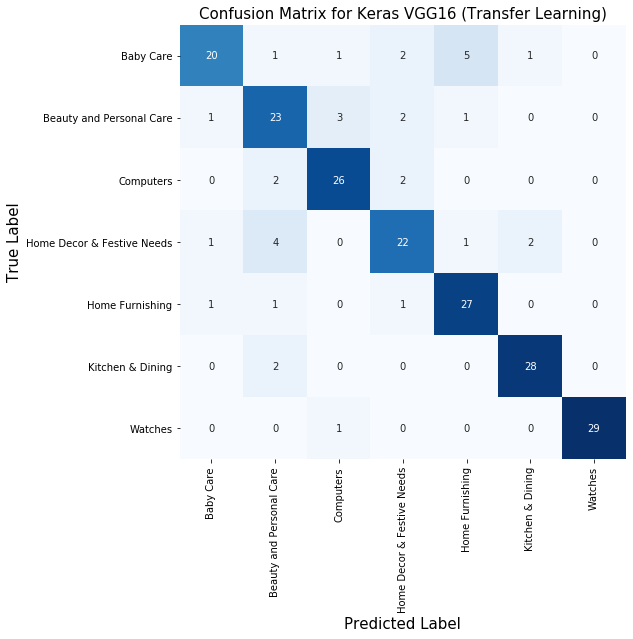

In [54]:
test_keras_pred = new_model10.predict(test_keras)
print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))
print('_______________________________________________')

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning)',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)

### Save model batch size 10 

In [61]:
# Save the model structure
model_json = new_model10.to_json()
with open("model10.json", "w") as json_file:
    json_file.write(model_json)
    
# save model weight
new_model10.save_weights("model10.h5")
print("Saved model to disk")
 


Saved model to disk


In [62]:
# Test reloading the model 
# load json and create model
json_file = open('model10.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)

# load weights into new model
loaded_model.load_weights("model10.h5")



Test Score (accuracy):  0.8333333333333334
_______________________________________________


Text(0.5, 51.0, 'Predicted Label')

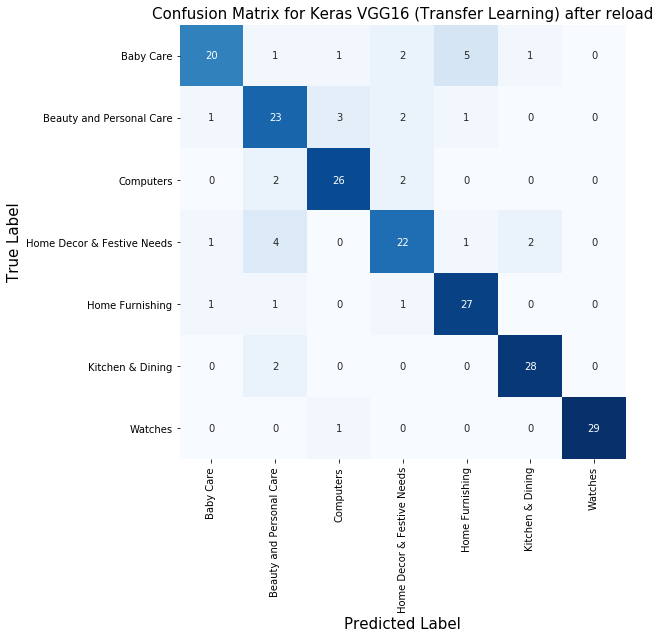

In [63]:
loaded_model.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

test_keras_pred = loaded_model.predict(test_keras)
print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))
print('_______________________________________________')

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning) after reload',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)

## Keras VGG16 Features Extraction + Kmeans 

### Load model + Images 

In [4]:
#For feature extraction we will simple take the 4096 features of the last layer as our output
new_model_kmeans = Model(inputs=model.inputs, outputs=(model.layers[-2].output))
# summarize
new_model_kmeans.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)      

In [5]:
train_kmeans = pd.read_csv('train.csv')
test_kmeans = pd.read_csv('test.csv')

In [6]:
base_train_images =  pd.read_csv('train.csv')
base_train_images = base_train_images.image
base_train_images

0      0bb0f7b7a3075f4b9459121abe2185fa.jpg
1      9ff54c12cc7ffd7c1a6724477b8fea2f.jpg
2      4e09d5a71d46d61de3d4c9c5aedb73f2.jpg
3      b454f9f449c9dff58b90113ba984ea98.jpg
4      ff24511994fc459d04145231c8876d6c.jpg
                       ...                 
835    9e90fb6c7870637b6f794e4b4c26bd7e.jpg
836    ec590694e8bf85f75c9200cf418127aa.jpg
837    7241df1acae1fac892c692097ea3fb98.jpg
838    1218fd9be42d45a81846db9f65a983bd.jpg
839    797d10fe966b3aa35933669c3425525b.jpg
Name: image, Length: 840, dtype: object

In [9]:
train_kmeans = load_keras(train_kmeans.image)

C:\Users\quent\anaconda3\lib\site-packages\PIL\Image.py:2766: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


In [10]:
# Predict the corresponding feature of our train dataset
train_kmeans_features = new_model_kmeans.predict(train_kmeans)

In [11]:
train_kmeans_features.shape

(840, 4096)

In [12]:
df_features = pd.DataFrame(train_kmeans_features)

In [77]:
df_features.describe()

,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
count,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,...,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000,840.000000
mean,0.675548,0.651498,0.394837,1.175756,0.475375,0.446568,1.067596,0.837067,0.079240,2.440439,...,0.507212,0.243063,0.073906,0.283030,0.485055,1.257111,0.605005,0.891704,0.455754,1.113614
std,1.566817,1.519426,0.960258,1.909640,1.123825,1.108077,1.929869,1.889211,0.522595,2.958074,...,1.288467,0.938964,0.418086,0.777641,1.130701,1.829407,1.305903,1.773159,1.202631,1.732517
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.299341,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.018923,0.000000,0.000000,0.000000,0.000000
75%,0.316359,0.005965,0.000000,1.951167,0.168345,0.103842,1.459474,0.545995,0.000000,4.108150,...,0.000000,0.000000,0.000000,0.000000,0.147856,2.096583,0.580851,0.994492,0.000000,1.729235
max,13.788172,12.145673,6.916348,11.986951,9.477144,11.162343,12.302332,18.117220,10.850916,17.257513,...,8.644670,8.964870,5.949490,7.075015,7.404163,11.657382,8.435526,11.144155,9.362056,9.224169


### Kmeans (TSNE representation)

In [13]:
std=StandardScaler()
df_features_scaled = std.fit_transform(df_features)

In [2]:
#TSNE representation of our train dataset
tsne = TSNE(n_components=2)
first_data_TSNE = tsne.fit_transform(df_features_scaled)



In [83]:
summary_silhouettes=pd.DataFrame()
silhouettes=[]

# Create a loop of 5 iteration (to observ stability)
for k in range(5):
    # Create a loop of to observ the result for each number of clusters chosen
    for i in range(2,20):
        cls= cluster.KMeans(n_clusters=i)
        cls.fit(df_features_scaled)
        silh= metrics.silhouette_score(df_features_scaled,cls.labels_)
        silhouettes.append(silh)
        
    summary_silhouettes['sil{}'.format(k)]=silhouettes
    silhouettes=[]

summary_silhouettes

,sil0,sil1,sil2,sil3,sil4
0,0.049524,0.049149,0.049221,0.049524,0.048518
1,0.021332,0.024586,0.020323,0.018229,0.025099
2,0.030083,0.023437,0.017687,0.025578,0.033025
3,0.035721,0.026598,0.027389,0.041321,0.030468
4,0.039031,0.038370,0.036533,0.038837,0.039264
5,0.038118,0.037558,0.045533,0.041326,0.046365
6,0.046435,0.045768,0.048856,0.045649,0.047837
7,0.047351,0.046528,0.042434,0.045396,0.046155
8,0.045743,0.046243,0.045317,0.049836,0.043542
9,0.045414,0.047299,0.044921,0.041465,0.037355


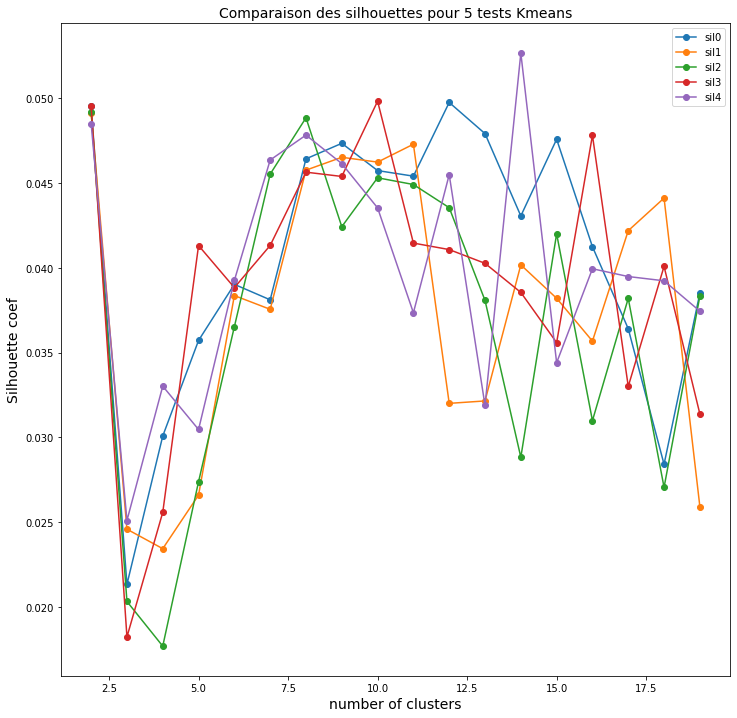

In [84]:
# Plot the result obtained above 
plt.figure(figsize=[12,12])
for col in summary_silhouettes.columns:
    plt.plot(range(2,20),summary_silhouettes[col],marker='o',label=col)
plt.title('Comparaison des silhouettes pour 5 tests Kmeans',fontsize=14)
plt.xlabel('number of clusters',fontsize=14)
plt.ylabel('Silhouette coef',fontsize=14)
plt.legend()

<Figure size 864x864 with 0 Axes>

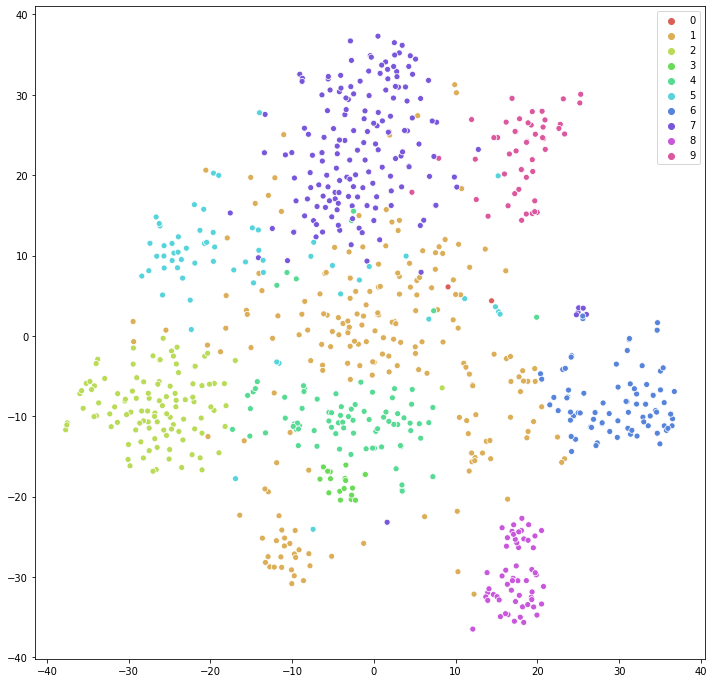

In [24]:
# TSNE of our train dataset with 10 clusters Kmeans
fig = plt.figure(figsize=[12,12])

cls10 = cluster.KMeans(n_clusters=10)
cls10.fit(df_features_scaled)

fig = plt.figure(figsize=[12,12])
sns.scatterplot(first_data_TSNE[:,0 ],
                first_data_TSNE[:,1],
                hue=cls10.labels_,
                legend='full',
                palette=sns.color_palette("hls",10))
plt.legend()

In [27]:
# Same function as in NLP part

def observ_cluster(data,labels):
    
    view_clusters = pd.Series(labels)
    
    pivot = data.drop(columns=['description','image'])
    pivot['label']=labels
    pivot['count']=1
    pivot = pivot.groupby(by=['label','category']).count().unstack().fillna(0)
    pivot.columns=pivot.columns.droplevel()
    
    pivot.plot(kind='bar',stacked=True,legend=True,figsize=(12,8),title='Category repartition per cluster')

    row_data=data.shape[0]

    if view_clusters.nunique() > 15:
        font = 8 
    else : 
        font = 12

    for index, value in enumerate(view_clusters.value_counts().sort_index(ascending=True)):
        percentage = np.around(value/row_data*100,1)   
        plt.text(index-0.25, value+2, str(percentage)+' %',fontsize=font)

    plt.xlabel('Cluster ID', fontsize=12)
    plt.ylabel('Number of sample', fontsize=12)
    plt.show()    
    
    return pivot


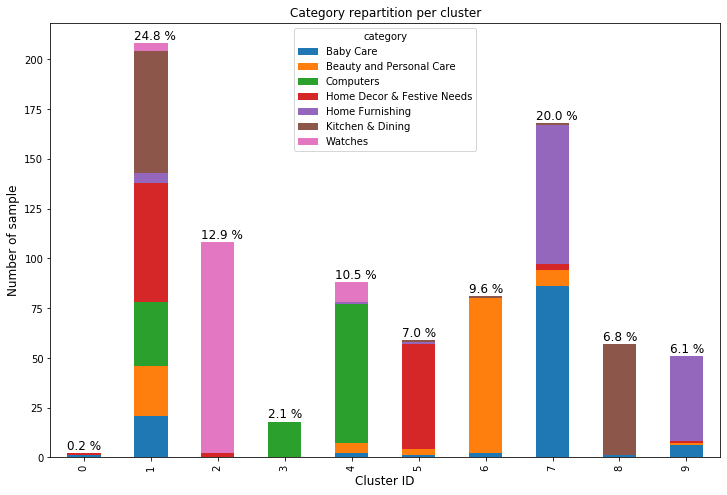

category,Baby Care,Beauty and Personal Care,Computers,Home Decor & Festive Needs,Home Furnishing,Kitchen & Dining,Watches
label,,,,,,,
0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
1,21.0,25.0,32.0,60.0,5.0,61.0,4.0
2,0.0,0.0,0.0,2.0,0.0,0.0,106.0
3,0.0,0.0,18.0,0.0,0.0,0.0,0.0
4,2.0,5.0,70.0,0.0,1.0,0.0,10.0
5,1.0,3.0,0.0,53.0,1.0,1.0,0.0
6,2.0,78.0,0.0,0.0,0.0,1.0,0.0
7,86.0,8.0,0.0,3.0,70.0,1.0,0.0
8,1.0,0.0,0.0,0.0,0.0,56.0,0.0


In [30]:
observ_cluster(train,cls10.labels_)

### TSNE + Image representation

In [15]:
tx, ty = first_data_TSNE[:,0], first_data_TSNE[:,1]
tx = (tx-np.min(tx)) / (np.max(tx) - np.min(tx))
ty = (ty-np.min(ty)) / (np.max(ty) - np.min(ty))

In [16]:
color = sns.color_palette("hls",8)

def sns_to_rgb(pal):
    for i in range(len(pal)):
        pal[i]= tuple(int(k * 255) for k in pal[i])
    return pal 

sns_to_rgb(color)[0]



(219, 94, 86)

In [17]:
# Function to add a colored margin around each image (to represent its cluster)

def add_margin(pil_img, top, right, bottom, left, color):
    width, height = pil_img.size
    new_width = width + right + left
    new_height = height + top + bottom
    result = Image.new(pil_img.mode, (new_width, new_height), color)
    result.paste(pil_img, (left, top))
    return result

In [21]:
cat = train.category.unique().tolist()
dict_cat = {}
for i in range(len(cat)):
    dict_cat[cat[i]]=i

dict_cat
    

{'Home Decor & Festive Needs': 0,
 'Baby Care': 1,
 'Beauty and Personal Care': 2,
 'Home Furnishing': 3,
 'Computers': 4,
 'Watches': 5,
 'Kitchen & Dining': 6}

C:\Users\quent\anaconda3\lib\site-packages\PIL\Image.py:2766: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


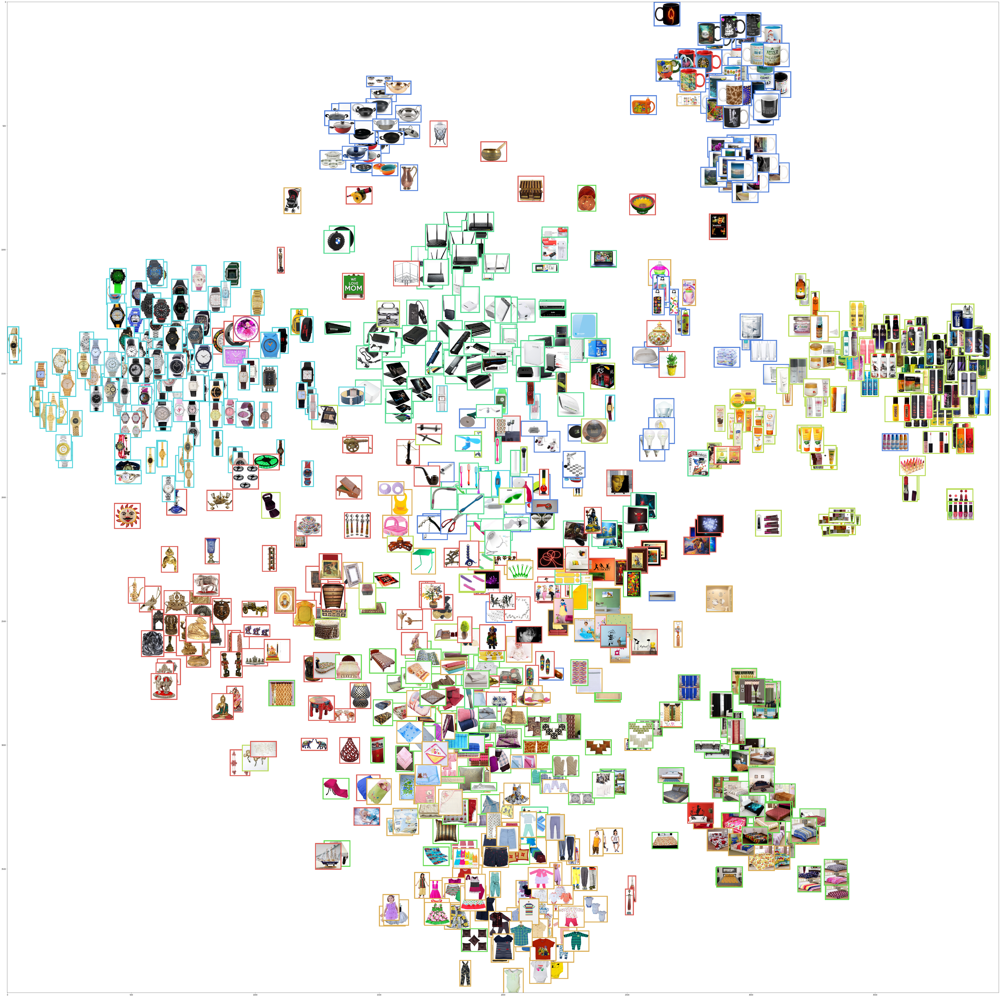

In [22]:
# Representation of base categories

width = 4000
height = 4000
max_dim = 100


lab_margin = 4
categ = train.category
pal = sns_to_rgb(sns.color_palette("hls",10))

full_image = Image.new('RGBA', (width, height))
for img, x, y, cats in zip(base_train_images, tx, ty, categ):
    
    path = "./Images/" + img
    tile = Image.open(path)
    
    rs = max(1, tile.width/max_dim, tile.height/max_dim)
    tile = tile.resize((int(tile.width/rs), int(tile.height/rs)), Image.ANTIALIAS)
    tile = add_margin(tile,lab_margin,lab_margin,lab_margin,lab_margin,color=pal[dict_cat[cats]])
    full_image.paste(tile, (int((width-max_dim)*x), int((height-max_dim)*y)), mask=tile.convert('RGBA'))

plt.figure(figsize = (100,100))
imshow(full_image)

In [23]:
full_image.save("tsne_base_categ.png")

C:\Users\quent\anaconda3\lib\site-packages\PIL\Image.py:2766: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


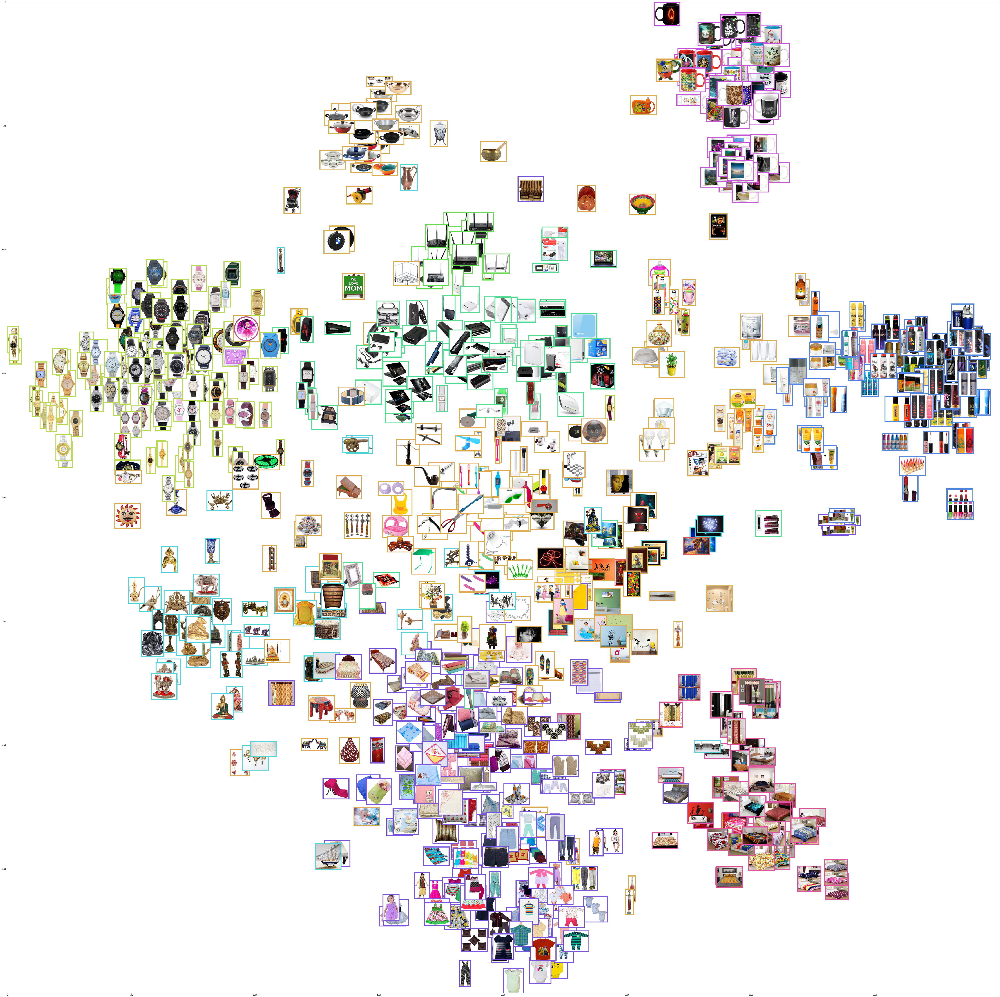

In [25]:
# Representation of new found clusters

width = 4000
height = 4000
max_dim = 100


lab_margin = 4
labels = cls10.labels_
pal = sns_to_rgb(sns.color_palette("hls",10))

full_image = Image.new('RGBA', (width, height))
for img, x, y, lab in zip(base_train_images, tx, ty, labels):
    
    path = "./Images/" + img
    tile = Image.open(path)
    
    rs = max(1, tile.width/max_dim, tile.height/max_dim)
    tile = tile.resize((int(tile.width/rs), int(tile.height/rs)), Image.ANTIALIAS)
    tile = add_margin(tile,lab_margin,lab_margin,lab_margin,lab_margin,color=pal[lab])
    full_image.paste(tile, (int((width-max_dim)*x), int((height-max_dim)*y)), mask=tile.convert('RGBA'))

plt.figure(figsize = (100,100))
imshow(full_image)

In [31]:
full_image.save("tsne_images2.png")

## Keras model DIY

In [313]:
# Same function but with 448 * 448 size

def load_keras_perso(list_of_path):
    
    for i in range(len(list_of_path)):
        if i ==0:
            path = "./Images/" + list_of_path[i]
            img = load_img(path, target_size=(448, 448))  # Charger l'image
            img = img_to_array(img)  # Convertir en tableau numpy
            img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))  # Créer la collection d'images (un seul échantillon)
            img = preprocess_input(img)  # Prétraiter l'image comme le veut VGG-16
        else: 
            path = "./Images/" + list_of_path[i]
            im = load_img(path, target_size=(448, 448))  # Charger l'image
            im = img_to_array(im)  # Convertir en tableau numpy
            im = im.reshape((1, im.shape[0], im.shape[1], im.shape[2]))  # Créer la collection d'images (un seul échantillon)
            im = preprocess_input(im)  # Prétraiter l'image comme le veut VGG-16
            img = np.concatenate((img, im), axis=0)
    
    return img

In [315]:
train_perso,validation_perso = train_test_split(train,
                                    test_size=0.20,
                                    stratify=train.category)
train_perso=train_perso.reset_index()
validation_perso=validation_perso.reset_index()

In [316]:
train_perso.shape

(672, 4)

In [317]:
train_keras_perso = load_keras_perso(train_perso.image)
validation_keras_perso = load_keras_perso(validation_perso.image)
train_keras_perso.shape

C:\Users\quent\anaconda3\lib\site-packages\PIL\Image.py:2766: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


(672, 448, 448, 3)

In [320]:
ohe = OneHotEncoder(handle_unknown='ignore')
y_train = ohe.fit_transform(np.array(train_perso.category).reshape(-1,1)).todense()
y_val = ohe.transform(np.array(validation_perso.category).reshape(-1,1)).todense()

In [321]:
test_keras_perso = load_keras_perso(test.image)
y_test = ohe.transform(np.array(test.category).reshape(-1,1)).todense()

# test_keras_pred = new_model.predict(test_keras_perso)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


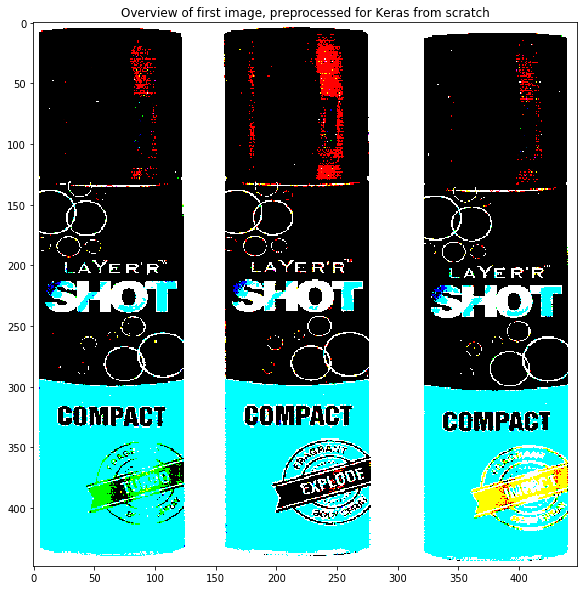

In [333]:
plt.figure(figsize=(10,10))
plt.title('Overview of first image, preprocessed for Keras from scratch')
plt.imshow(train_keras_perso[2])
plt.show()

### High quantity parameters

In [154]:
my_VGG16 = Sequential()  # Create new empty neural network  

# Add first convulational layer with ReLU activation
my_VGG16.add(Conv2D(16, (3, 3), input_shape=(448, 448, 3), padding='same', activation='relu'))
my_VGG16.add(Conv2D(16, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
my_VGG16.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
my_VGG16.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
my_VGG16.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
my_VGG16.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Flatten())
my_VGG16.add(Dense(2048, activation='softmax'))
my_VGG16.add(Dense(7, activation='softmax'))
my_VGG16.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 448, 448, 16)      448       
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 448, 448, 16)      2320      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 224, 224, 16)      0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 224, 224, 32)      4640      
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 224, 224, 32)      9248      
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 112, 112, 64)     

In [166]:
monitor=EarlyStopping(monitor='val_loss',
                      min_delta=1e-3,
                      patience=5,
                      verbose=2,
                      restore_best_weights=True)

# Compiler le modèle 
my_VGG16.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

# Entraîner sur les données d'entraînement (X_train, y_train)
model_info = my_VGG16.fit(train_keras_perso,
                           y_train,
                           callbacks=monitor,
                           validation_data=(validation_keras_perso,y_val),
                           epochs=30,
                           batch_size=10,
                           verbose=2)

Epoch 1/30
68/68 - 328s - loss: 1.9475 - accuracy: 0.1369 - val_loss: 1.9459 - val_accuracy: 0.1481
Epoch 2/30
68/68 - 331s - loss: 1.9467 - accuracy: 0.1176 - val_loss: 1.9458 - val_accuracy: 0.1481
Epoch 3/30
68/68 - 347s - loss: 1.9468 - accuracy: 0.1310 - val_loss: 1.9458 - val_accuracy: 0.1481
Epoch 4/30
68/68 - 356s - loss: 1.9465 - accuracy: 0.1295 - val_loss: 1.9458 - val_accuracy: 0.1481
Epoch 5/30
68/68 - 340s - loss: 1.9464 - accuracy: 0.1429 - val_loss: 1.9458 - val_accuracy: 0.1481
Epoch 6/30
Restoring model weights from the end of the best epoch.
68/68 - 338s - loss: 1.9466 - accuracy: 0.1235 - val_loss: 1.9458 - val_accuracy: 0.1481
Epoch 00006: early stopping



Test Score (accuracy):  0.14285714285714285
_______________________________________________


Text(0.5, 51.0, 'Predicted Label')

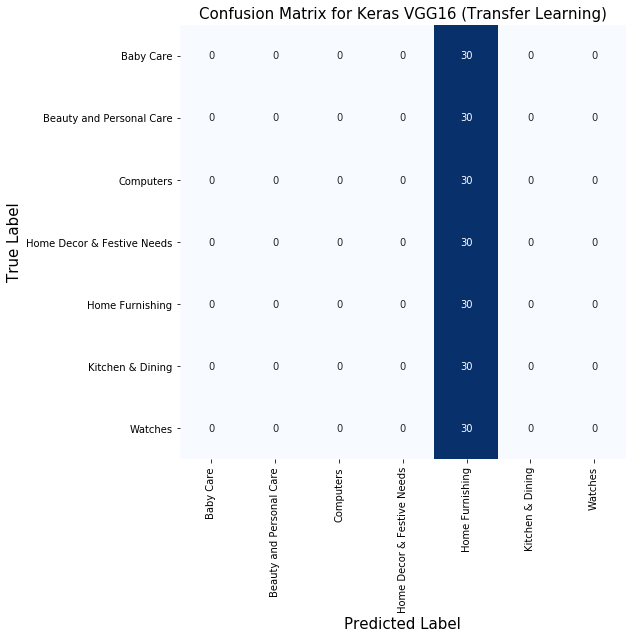

In [173]:
test_keras_pred = my_VGG16.predict(test_keras_perso)
print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))
print('_______________________________________________')

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning)',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)

### Low Quantity parameters

In [328]:
my_VGG16 = Sequential() 

my_VGG16.add(Conv2D(16, (3, 3), input_shape=(448, 448, 3), padding='same', activation='relu'))
my_VGG16.add(Conv2D(16, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
my_VGG16.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
my_VGG16.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
my_VGG16.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))

my_VGG16.add(Flatten())
my_VGG16.add(Dense(256, activation='softmax'))
my_VGG16.add(Dense(7, activation='softmax'))
my_VGG16.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_20 (Conv2D)           (None, 448, 448, 16)      448       
_________________________________________________________________
conv2d_21 (Conv2D)           (None, 448, 448, 16)      2320      
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 224, 224, 16)      0         
_________________________________________________________________
conv2d_22 (Conv2D)           (None, 224, 224, 32)      4640      
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 224, 224, 32)      9248      
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_24 (Conv2D)           (None, 112, 112, 64)     

In [329]:
monitor=EarlyStopping(monitor='val_loss',
                      min_delta=1e-3,
                      patience=5,
                      verbose=2,
                      restore_best_weights=True)

# Compiler le modèle 
my_VGG16.compile(loss="categorical_crossentropy", optimizer='adam', metrics=["accuracy"])

# Entraîner sur les données d'entraînement (X_train, y_train)
model_info = my_VGG16.fit(train_keras_perso,
                           y_train,
                           callbacks=monitor,
                           validation_data=(validation_keras_perso,y_val),
                           epochs=30,
                           batch_size=30,
                           verbose=2)

Epoch 1/30
23/23 - 276s - loss: 1.9501 - accuracy: 0.1369 - val_loss: 1.9486 - val_accuracy: 0.1429
Epoch 2/30
23/23 - 242s - loss: 1.9486 - accuracy: 0.1429 - val_loss: 1.9481 - val_accuracy: 0.1429
Epoch 3/30
23/23 - 190s - loss: 1.9481 - accuracy: 0.1429 - val_loss: 1.9477 - val_accuracy: 0.1429
Epoch 4/30
23/23 - 185s - loss: 1.9477 - accuracy: 0.1429 - val_loss: 1.9472 - val_accuracy: 0.1429
Epoch 5/30
23/23 - 188s - loss: 1.9473 - accuracy: 0.1429 - val_loss: 1.9469 - val_accuracy: 0.1429
Epoch 6/30
23/23 - 185s - loss: 1.9470 - accuracy: 0.1429 - val_loss: 1.9468 - val_accuracy: 0.1429
Epoch 7/30
23/23 - 183s - loss: 1.9469 - accuracy: 0.1429 - val_loss: 1.9467 - val_accuracy: 0.1429
Epoch 8/30
23/23 - 183s - loss: 1.9467 - accuracy: 0.1429 - val_loss: 1.9464 - val_accuracy: 0.1429
Epoch 9/30
Restoring model weights from the end of the best epoch.
23/23 - 184s - loss: 1.9466 - accuracy: 0.1354 - val_loss: 1.9463 - val_accuracy: 0.1429
Epoch 00009: early stopping



Test Score (accuracy):  0.14285714285714285
_______________________________________________


Text(0.5, 51.0, 'Predicted Label')

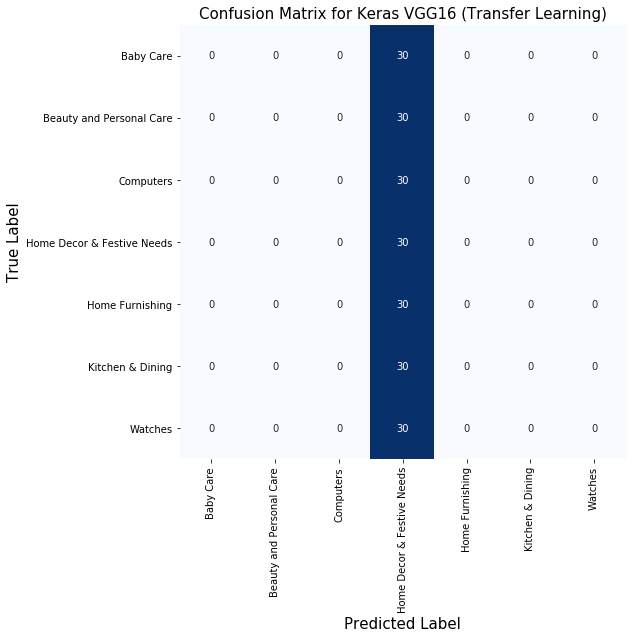

In [330]:
test_keras_pred = my_VGG16.predict(test_keras_perso)
print('\nTest Score (accuracy): ',accuracy_score(np.argmax(test_keras_pred, axis=1).reshape(-1,1), 
                                                 np.argmax(y_test, axis=1).reshape(-1,1)))
print('_______________________________________________')

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(np.argmax(y_test, axis=1).reshape(-1,1),
                      np.argmax(test_keras_pred,axis=1).reshape(-1,1))

plt.figure(figsize=(8,8))
plt.title('Confusion Matrix for Keras VGG16 (Transfer Learning)',fontsize=15)
f = sns.heatmap(cm,
                cmap='Blues',
                cbar=False,
                annot=True,
                xticklabels=list(ohe.categories_[0]),
                yticklabels=list(ohe.categories_[0]))
f.set_ylabel('True Label',fontsize=15)
f.set_xlabel('Predicted Label',fontsize=15)

Here it seems like we cannot find a configuration which gives us correct result (<b>accuracy 14.3% means that we predict always the same category</b>). We would probably need way more pictures so as to have better results.
The third (and last) part concerns models with both NLP and image classification (section P06_03)